## Import the packages

In [1]:
import hssm
import hssm.plotting
import numpy as np
import pandas as pd
import arviz as az
import seaborn as sns
from matplotlib import pyplot as plt
import bambi as bmb
import re
from hssm_analysis_helpers import hssm_analyze 

# Summarize the model
def generate_summary_with_posterior_prob(model, var_names):
    """
    Generate a summary table for the given model and variables,
    and add the posterior probability of being < 0 for each parameter.
    """
    # Get standard summary
    summary_df = az.summary(model._inference_obj, var_names=var_names)

    # Compute posterior probabilities < 0
    probs_below_zero = []
    for var in var_names:
        samples = az.extract(model._inference_obj, var_names=var, combined=True).values
        prob = np.mean(samples < 0)
        probs_below_zero.append(prob)

    # Add as new column
    summary_df["P(< 0)"] = probs_below_zero

    # Round all values to 2 decimals
    summary_df = summary_df.round(2)

    return summary_df

/users/igrahek/.conda/envs/pyHSSM_New_Nov24/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Linear Age 

### Summary

In [2]:
# Set parameters
model_name = 'Model1'
var_names=["v_Intercept",
           "v_intervalType",
           "v_blockType",
           "v_congruency",
           "v_Age",
           "v_intervalType:Age",
           "v_blockType:Age",
           "v_intervalType:blockType",
           "v_intervalType:blockType:Age",
           "a_Intercept",
           "a_scaledRunningTime", 
           "a_intervalType", 
           "a_blockType", 
           "a_Age",
           "a_intervalType:Age",
           "a_blockType:Age",
           "a_intervalType:blockType",
           "a_intervalType:blockType:Age",
           "z_Intercept",
           "z_congruency", 
           "t_Intercept", 
           "t_intervalType",
           "p_outlier"]

# Attach the samples
model = hssm_analyze.load_model(model_name)

summary_with_prob = generate_summary_with_posterior_prob(model, var_names)
summary_with_prob


<string>:9: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
<string>:10: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
<string>:11: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`


User supplied initial value detected for v_Intercept, 
 skipping overwrite with default value.
User supplied initial value detected for a_Intercept, 
 skipping overwrite with default value.
User supplied initial value detected for t_Intercept, 
 skipping overwrite with default value.
Model initialized successfully.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat,P(< 0)
v_Intercept,2.57,0.05,2.48,2.66,0.00,0.00,238.0,430.0,1.01,0.00
v_intervalType,0.57,0.04,0.50,0.66,0.00,0.00,511.0,743.0,1.00,0.00
v_blockType,-0.06,0.03,-0.12,-0.01,0.00,0.00,851.0,1111.0,1.00,0.98
v_congruency,0.75,0.03,0.70,0.82,0.00,0.00,929.0,1487.0,1.00,0.00
v_Age,-0.11,0.20,-0.52,0.24,0.02,0.01,198.0,579.0,1.03,0.71
v_intervalType:Age,0.04,0.18,-0.28,0.39,0.01,0.00,621.0,769.0,1.00,0.42
v_blockType:Age,-0.12,0.13,-0.38,0.12,0.00,0.00,927.0,1491.0,1.00,0.81
v_intervalType:blockType,0.29,0.05,0.21,0.38,0.00,0.00,979.0,1183.0,1.01,0.00
v_intervalType:blockType:Age,0.64,0.20,0.22,0.98,0.01,0.00,1047.0,1128.0,1.00,0.00
a_Intercept,1.09,0.02,1.06,1.12,0.00,0.00,276.0,521.0,1.01,0.00


In [3]:
x = (az.extract(model._inference_obj,var_names = 'v_intervalType',combined=True)).values
np.mean(x < 0)

0.0

### Traces

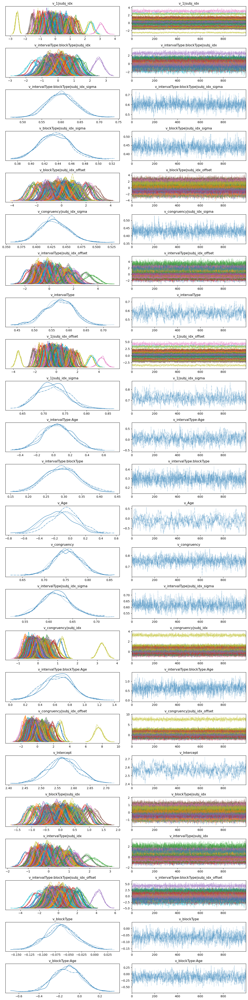

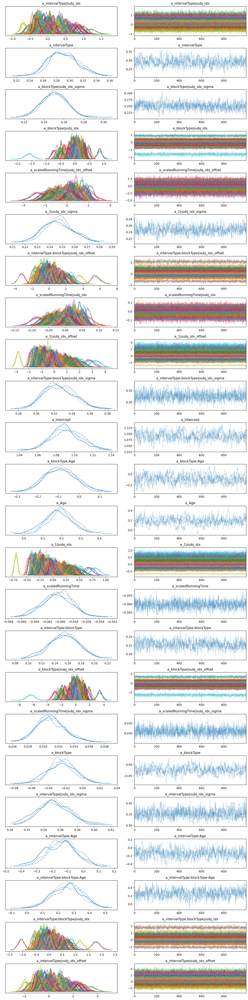

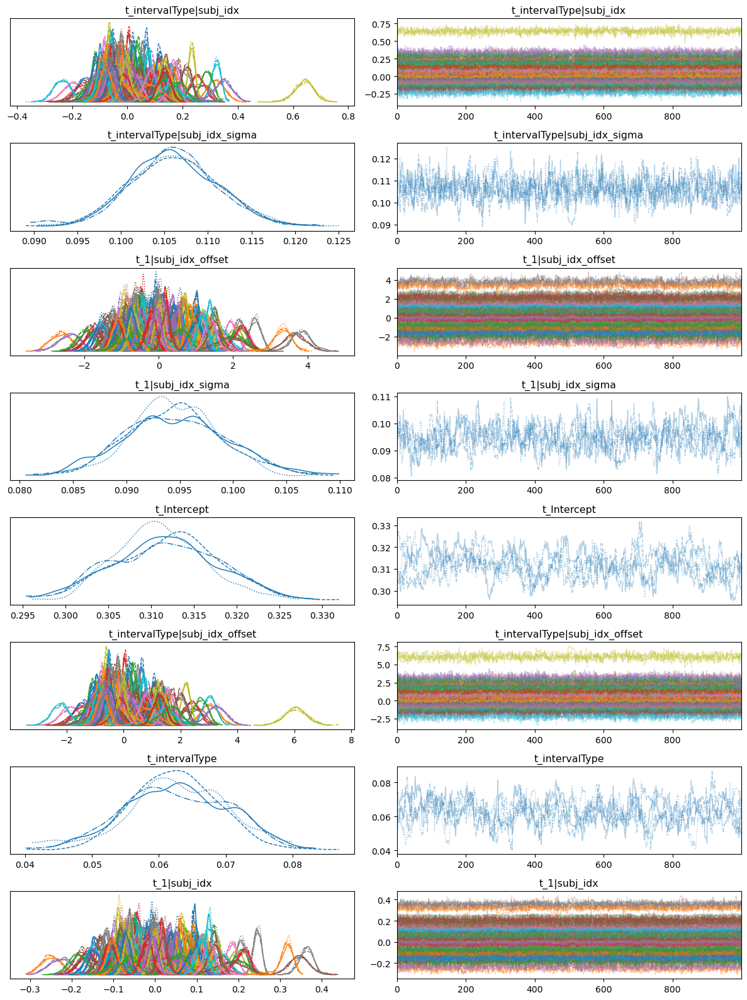

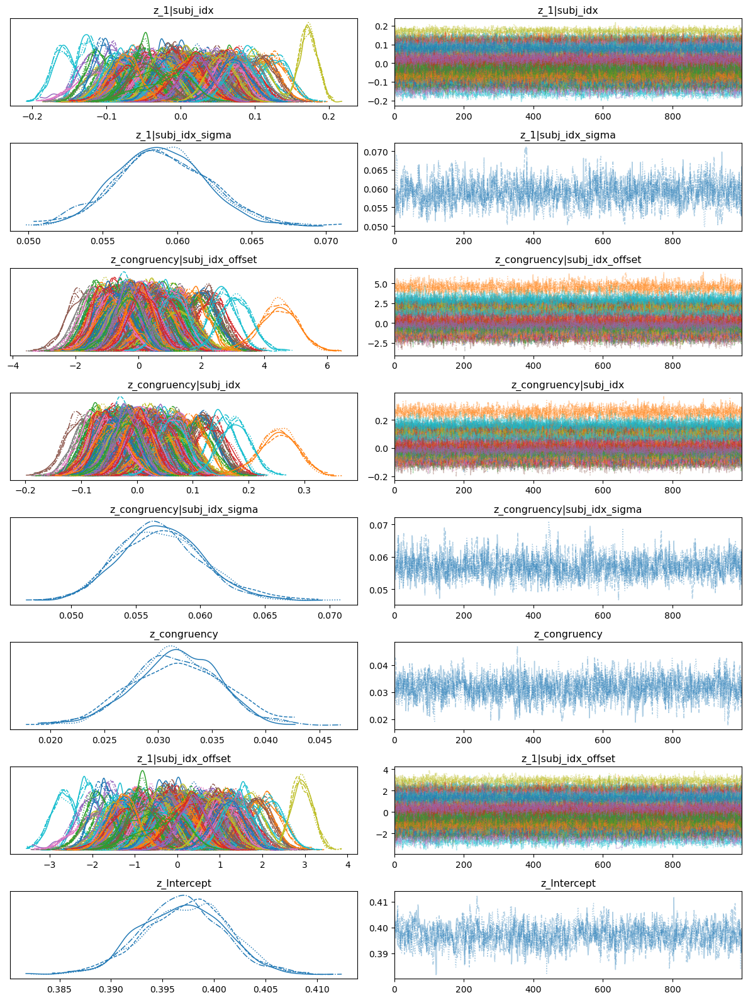

In [4]:
# Plot traces
hssm_analyze.plot_traces(model, var_names='v_') 
hssm_analyze.plot_traces(model, var_names='a_') 
hssm_analyze.plot_traces(model, var_names='t_') 
hssm_analyze.plot_traces(model, var_names='z_') 

### PPCs

No posterior predictive samples found. Generating posterior predictive samples using the provided InferenceData object and the original data. This will modify the provided InferenceData object, or if not provided, the traces object stored inside the model.


<Figure size 3000x3000 with 0 Axes>

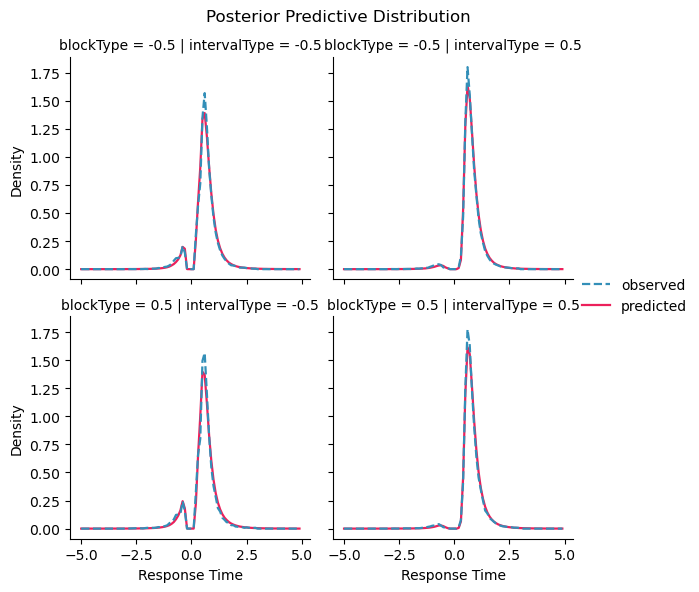

In [5]:
# Plot the PPCs
hssm_analyze.plot_ppcs(model, col_var="intervalType", row_var="blockType", x_size=30, y_size=30,range=5)

<Figure size 5000x7500 with 0 Axes>

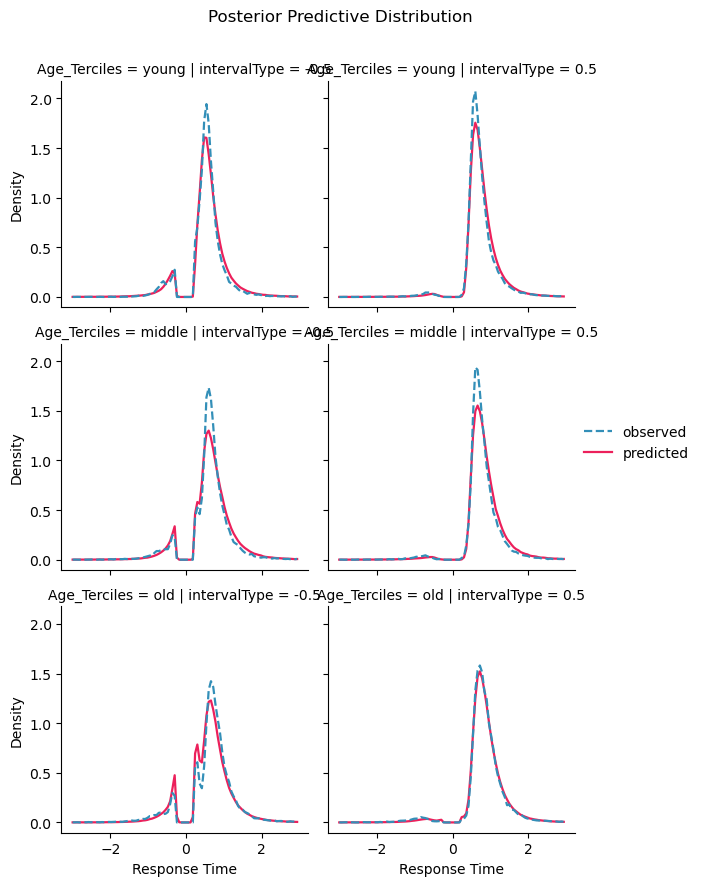

In [6]:
model.data['Age_Terciles'] = pd.qcut(model.data['Age'], q=3, labels=['young', 'middle', 'old'])
hssm_analyze.plot_ppcs(model, col_var="intervalType", row_var="Age_Terciles", x_size=50, y_size=75,range=3)
import matplotlib.pyplot as plt
plt.savefig('FigureS1.svg',dpi=900)

### Save traces

#### Group-level

In [7]:
#### Drift ####

# Extract the means
v_Intercept = (az.extract(model._inference_obj,var_names = 'v_Intercept',combined=True)).mean().values
v_Interval = (az.extract(model._inference_obj,var_names = 'v_intervalType',combined=True)).values
v_Block = (az.extract(model._inference_obj,var_names = 'v_blockType',combined=True)).values
v_IntervalXBlock = (az.extract(model._inference_obj,var_names = 'v_intervalType:blockType',combined=True)).values

# Recreate the conditions
v_SpeedFixed = v_Intercept -0.5*v_Interval + 0.5*v_Block - 0.25*v_IntervalXBlock
v_SpeedVarying = v_Intercept - 0.5*v_Interval - 0.5*v_Block + 0.25*v_IntervalXBlock
v_AccuracyFixed = v_Intercept + 0.5*v_Interval + 0.5*v_Block + 0.25*v_IntervalXBlock
v_AccuracyVarying = v_Intercept + 0.5*v_Interval - 0.5*v_Block - 0.25*v_IntervalXBlock
v_Speed = v_Intercept - 0.5*v_Interval
v_Accuracy = v_Intercept + 0.5*v_Interval
v_Fixed = v_Intercept + 0.5*v_Block
v_Varying = v_Intercept - 0.5*v_Block

#### Threshold ####

# Extract the means
a_Intercept = (az.extract(model._inference_obj,var_names = 'a_Intercept',combined=True)).mean().values
a_Interval = (az.extract(model._inference_obj,var_names = 'a_intervalType',combined=True)).values
a_Block = (az.extract(model._inference_obj,var_names = 'a_blockType',combined=True)).values
a_IntervalXBlock = (az.extract(model._inference_obj,var_names = 'a_intervalType:blockType',combined=True)).values

# Recreate the conditions
a_SpeedFixed = a_Intercept - 0.5*a_Interval + 0.5*a_Block - 0.25*a_IntervalXBlock
a_SpeedVarying = a_Intercept - 0.5*a_Interval - 0.5*a_Block + 0.25*a_IntervalXBlock
a_AccuracyFixed = a_Intercept + 0.5*a_Interval + 0.5*a_Block + 0.25*a_IntervalXBlock
a_AccuracyVarying = a_Intercept + 0.5*a_Interval - 0.5*a_Block - 0.25*a_IntervalXBlock
a_Speed = a_Intercept - 0.5*a_Interval
a_Accuracy = a_Intercept + 0.5*a_Interval
a_Fixed = a_Intercept + 0.5*a_Block
a_Varying = a_Intercept - 0.5*a_Block

# Create a DataFrame with all the conditions
data = {
    'v_Speed_Fixed': v_SpeedFixed,
    'v_Accuracy_Fixed': v_AccuracyFixed,
    'v_Speed_Varying': v_SpeedVarying,
    'v_Accuracy_Varying': v_AccuracyVarying,
    'v_Speed': v_Speed,
    'v_Accuracy': v_Accuracy,
    'v_Fixed': v_Fixed,
    'v_Varying': v_Varying,

    'a_Speed_Fixed': a_SpeedFixed,
    'a_Accuracy_Fixed': a_AccuracyFixed,
    'a_Speed_Varying': a_SpeedVarying,
    'a_Accuracy_Varying': a_AccuracyVarying,
    'a_Speed': a_Speed,
    'a_Accuracy': a_Accuracy,
    'a_Fixed': a_Fixed,
    'a_Varying': a_Varying,
}

df_conditions = pd.DataFrame(data)

# Save DataFrame as CSV
df_conditions.to_csv('Posteriors_FixedVarying.csv', index=False)

#### Save posteriors for particular ages (3 groups)

In [8]:
# Set the z-scores for groups (the age predictor is multiplied by 100 before entered in the model, so we multiply it here as well)
young = -0.003905316 * 100 # 20
middle = -0.001473273 *100 # 40
old = 0.00095877 * 100     # 60

young = -0.002689295 * 100 # 30
middle = -0.000257251 *100 # 50
old = 0.002174792 * 100     # 70

young = -0.003297306 * 100 # 25
middle = -0.000865262 *100 # 45
old = 0.001566781 * 100     # 65

#### Drift ####

# Extract the means
v_Intercept = (az.extract(model._inference_obj,var_names = 'v_Intercept',combined=True)).mean().values
v_Interval = 0.5*(az.extract(model._inference_obj,var_names = 'v_intervalType',combined=True)).values
v_Block = 0.5*(az.extract(model._inference_obj,var_names = 'v_blockType',combined=True)).values
v_Age = (az.extract(model._inference_obj,var_names = 'v_Age',combined=True)).values

v_IntervalXBlock = 0.25*(az.extract(model._inference_obj,var_names = 'v_intervalType:blockType',combined=True)).values
v_IntervalXAge = 0.5*(az.extract(model._inference_obj,var_names = 'v_intervalType:Age',combined=True)).values
v_BlockXAge = 0.5*(az.extract(model._inference_obj,var_names = 'v_blockType:Age',combined=True)).values
v_IntervalXBlockXAge = 0.25*(az.extract(model._inference_obj,var_names = 'v_intervalType:blockType:Age',combined=True)).values

# Recreate the conditions
v_SpeedFixed_young = v_Intercept - v_Interval + v_Block - v_IntervalXBlock + young*v_Age - young*v_IntervalXAge + young*v_BlockXAge - young*v_IntervalXBlockXAge
v_SpeedVarying_young = v_Intercept - v_Interval - v_Block + v_IntervalXBlock + young*v_Age - young*v_IntervalXAge - young*v_BlockXAge + young*v_IntervalXBlockXAge
v_AccuracyFixed_young = v_Intercept + v_Interval + v_Block + v_IntervalXBlock + young*v_Age + young*v_IntervalXAge + young*v_BlockXAge + young*v_IntervalXBlockXAge
v_AccuracyVarying_young = v_Intercept + v_Interval - v_Block - v_IntervalXBlock + young*v_Age + young*v_IntervalXAge - young*v_BlockXAge - young*v_IntervalXBlockXAge
v_Speed_young = v_Intercept - v_Interval + young*v_Age - young*v_IntervalXAge
v_Accuracy_young = v_Intercept + v_Interval + young*v_Age + young*v_IntervalXAge
v_Fixed_young   = v_Intercept + v_Block + young*v_Age + young*v_BlockXAge
v_Varying_young = v_Intercept - v_Block + young*v_Age - young*v_BlockXAge

v_SpeedFixed_middle = v_Intercept - v_Interval + v_Block - v_IntervalXBlock + middle*v_Age - middle*v_IntervalXAge + middle*v_BlockXAge - middle*v_IntervalXBlockXAge
v_SpeedVarying_middle = v_Intercept - v_Interval - v_Block + v_IntervalXBlock + middle*v_Age - middle*v_IntervalXAge - middle*v_BlockXAge + middle*v_IntervalXBlockXAge
v_AccuracyFixed_middle = v_Intercept + v_Interval + v_Block + v_IntervalXBlock + middle*v_Age + middle*v_IntervalXAge + middle*v_BlockXAge + middle*v_IntervalXBlockXAge
v_AccuracyVarying_middle = v_Intercept + v_Interval - v_Block - v_IntervalXBlock + middle*v_Age + middle*v_IntervalXAge - middle*v_BlockXAge - middle*v_IntervalXBlockXAge
v_Speed_middle = v_Intercept - v_Interval + middle*v_Age - middle*v_IntervalXAge
v_Accuracy_middle = v_Intercept + v_Interval + middle*v_Age + middle*v_IntervalXAge
v_Fixed_middle   = v_Intercept + v_Block + middle*v_Age + middle*v_BlockXAge
v_Varying_middle = v_Intercept - v_Block + middle*v_Age - middle*v_BlockXAge

v_SpeedFixed_old = v_Intercept - v_Interval + v_Block - v_IntervalXBlock + old*v_Age - old*v_IntervalXAge + old*v_BlockXAge - old*v_IntervalXBlockXAge
v_SpeedVarying_old = v_Intercept - v_Interval - v_Block + v_IntervalXBlock + old*v_Age - old*v_IntervalXAge - old*v_BlockXAge + old*v_IntervalXBlockXAge
v_AccuracyFixed_old = v_Intercept + v_Interval + v_Block + v_IntervalXBlock + old*v_Age + old*v_IntervalXAge + old*v_BlockXAge + old*v_IntervalXBlockXAge
v_AccuracyVarying_old = v_Intercept + v_Interval - v_Block - v_IntervalXBlock + old*v_Age + old*v_IntervalXAge - old*v_BlockXAge - old*v_IntervalXBlockXAge
v_Speed_old = v_Intercept - v_Interval + old*v_Age - old*v_IntervalXAge
v_Accuracy_old = v_Intercept + v_Interval + old*v_Age + old*v_IntervalXAge
v_Fixed_old   = v_Intercept + v_Block + old*v_Age + old*v_BlockXAge
v_Varying_old = v_Intercept - v_Block + old*v_Age - old*v_BlockXAge


#### Threshold ####

# Extract the means
a_Intercept = (az.extract(model._inference_obj,var_names = 'a_Intercept',combined=True)).mean().values
a_Interval = 0.5*(az.extract(model._inference_obj,var_names = 'a_intervalType',combined=True)).values
a_Block = 0.5*(az.extract(model._inference_obj,var_names = 'a_blockType',combined=True)).values
a_Age = (az.extract(model._inference_obj,var_names = 'a_Age',combined=True)).values

a_IntervalXBlock = 0.25*(az.extract(model._inference_obj,var_names = 'a_intervalType:blockType',combined=True)).values
a_IntervalXAge = 0.5*(az.extract(model._inference_obj,var_names = 'a_intervalType:Age',combined=True)).values
a_BlockXAge = 0.5*(az.extract(model._inference_obj,var_names = 'a_blockType:Age',combined=True)).values
a_IntervalXBlockXAge = 0.25*(az.extract(model._inference_obj,var_names = 'a_intervalType:blockType:Age',combined=True)).values

# Recreate the conditions
a_SpeedFixed_young = a_Intercept - a_Interval + a_Block - a_IntervalXBlock + young*a_Age - young*a_IntervalXAge + young*a_BlockXAge - young*a_IntervalXBlockXAge
a_SpeedVarying_young = a_Intercept - a_Interval - a_Block + a_IntervalXBlock + young*a_Age - young*a_IntervalXAge - young*a_BlockXAge + young*a_IntervalXBlockXAge
a_AccuracyFixed_young = a_Intercept + a_Interval + a_Block + a_IntervalXBlock + young*a_Age + young*a_IntervalXAge + young*a_BlockXAge + young*a_IntervalXBlockXAge
a_AccuracyVarying_young = a_Intercept + a_Interval - a_Block - a_IntervalXBlock + young*a_Age + young*a_IntervalXAge - young*a_BlockXAge - young*a_IntervalXBlockXAge
a_Speed_young = a_Intercept - a_Interval + young*a_Age - young*a_IntervalXAge
a_Accuracy_young = a_Intercept + a_Interval + young*a_Age + young*a_IntervalXAge
a_Fixed_young   = a_Intercept + a_Block + young*a_Age + young*a_BlockXAge
a_Varying_young = a_Intercept - a_Block + young*a_Age - young*a_BlockXAge

a_SpeedFixed_middle = a_Intercept - a_Interval + a_Block - a_IntervalXBlock + middle*a_Age - middle*a_IntervalXAge + middle*a_BlockXAge - middle*a_IntervalXBlockXAge
a_SpeedVarying_middle = a_Intercept - a_Interval - a_Block + a_IntervalXBlock + middle*a_Age - middle*a_IntervalXAge - middle*a_BlockXAge + middle*a_IntervalXBlockXAge
a_AccuracyFixed_middle = a_Intercept + a_Interval + a_Block + a_IntervalXBlock + middle*a_Age + middle*a_IntervalXAge + middle*a_BlockXAge + middle*a_IntervalXBlockXAge
a_AccuracyVarying_middle = a_Intercept + a_Interval - a_Block - a_IntervalXBlock + middle*a_Age + middle*a_IntervalXAge - middle*a_BlockXAge - middle*a_IntervalXBlockXAge
a_Speed_middle = a_Intercept - a_Interval + middle*a_Age - middle*a_IntervalXAge
a_Accuracy_middle = a_Intercept + a_Interval + middle*a_Age + middle*a_IntervalXAge
a_Fixed_middle   = a_Intercept + a_Block + middle*a_Age + middle*a_BlockXAge
a_Varying_middle = a_Intercept - a_Block + middle*a_Age - middle*a_BlockXAge

a_SpeedFixed_old = a_Intercept - a_Interval + a_Block - a_IntervalXBlock + old*a_Age - old*a_IntervalXAge + old*a_BlockXAge - old*a_IntervalXBlockXAge
a_SpeedVarying_old = a_Intercept - a_Interval - a_Block + a_IntervalXBlock + old*a_Age - old*a_IntervalXAge - old*a_BlockXAge + old*a_IntervalXBlockXAge
a_AccuracyFixed_old = a_Intercept + a_Interval + a_Block + a_IntervalXBlock + old*a_Age + old*a_IntervalXAge + old*a_BlockXAge + old*a_IntervalXBlockXAge
a_AccuracyVarying_old = a_Intercept + a_Interval - a_Block - a_IntervalXBlock + old*a_Age + old*a_IntervalXAge - old*a_BlockXAge - old*a_IntervalXBlockXAge
a_Speed_old = a_Intercept - a_Interval + old*a_Age - old*a_IntervalXAge
a_Accuracy_old = a_Intercept + a_Interval + old*a_Age + old*a_IntervalXAge
a_Fixed_old   = a_Intercept + a_Block + old*a_Age + old*a_BlockXAge
a_Varying_old = a_Intercept - a_Block + old*a_Age - old*a_BlockXAge

# Create combined DataFrame directly
combined_df = pd.DataFrame({
    # --- v Young ---
    'v_Speed_Fixed_young': v_SpeedFixed_young,
    'v_Accuracy_Fixed_young': v_AccuracyFixed_young,
    'v_Speed_Varying_young': v_SpeedVarying_young,
    'v_Accuracy_Varying_young': v_AccuracyVarying_young,
    'v_Speed_young': v_Speed_young,
    'v_Accuracy_young': v_Accuracy_young,
    'v_Fixed_young': v_Fixed_young,
    'v_Varying_young': v_Varying_young,

    # --- a Young ---
    'a_Speed_Fixed_young': a_SpeedFixed_young,
    'a_Accuracy_Fixed_young': a_AccuracyFixed_young,
    'a_Speed_Varying_young': a_SpeedVarying_young,
    'a_Accuracy_Varying_young': a_AccuracyVarying_young,
    'a_Speed_young': a_Speed_young,
    'a_Accuracy_young': a_Accuracy_young,
    'a_Fixed_young': a_Fixed_young,
    'a_Varying_young': a_Varying_young,

    # --- v Middle ---
    'v_Speed_Fixed_middle': v_SpeedFixed_middle,
    'v_Accuracy_Fixed_middle': v_AccuracyFixed_middle,
    'v_Speed_Varying_middle': v_SpeedVarying_middle,
    'v_Accuracy_Varying_middle': v_AccuracyVarying_middle,
    'v_Speed_middle': v_Speed_middle,
    'v_Accuracy_middle': v_Accuracy_middle,
    'v_Fixed_middle': v_Fixed_middle,
    'v_Varying_middle': v_Varying_middle,

    # --- a Middle ---
    'a_Speed_Fixed_middle': a_SpeedFixed_middle,
    'a_Accuracy_Fixed_middle': a_AccuracyFixed_middle,
    'a_Speed_Varying_middle': a_SpeedVarying_middle,
    'a_Accuracy_Varying_middle': a_AccuracyVarying_middle,
    'a_Speed_middle': a_Speed_middle,
    'a_Accuracy_middle': a_Accuracy_middle,
    'a_Fixed_middle': a_Fixed_middle,
    'a_Varying_middle': a_Varying_middle,

    # --- v Old ---
    'v_Speed_Fixed_old': v_SpeedFixed_old,
    'v_Accuracy_Fixed_old': v_AccuracyFixed_old,
    'v_Speed_Varying_old': v_SpeedVarying_old,
    'v_Accuracy_Varying_old': v_AccuracyVarying_old,
    'v_Speed_old': v_Speed_old,
    'v_Accuracy_old': v_Accuracy_old,
    'v_Fixed_old': v_Fixed_old,
    'v_Varying_old': v_Varying_old,

    # --- a Old ---
    'a_Speed_Fixed_old': a_SpeedFixed_old,
    'a_Accuracy_Fixed_old': a_AccuracyFixed_old,
    'a_Speed_Varying_old': a_SpeedVarying_old,
    'a_Accuracy_Varying_old': a_AccuracyVarying_old,
    'a_Speed_old': a_Speed_old,
    'a_Accuracy_old': a_Accuracy_old,
    'a_Fixed_old': a_Fixed_old,
    'a_Varying_old': a_Varying_old
})

# Save to CSV
combined_df.to_csv('Posteriors_FixedVarying_SpecificAges.csv', index=False)

#### Save posteriors for each subject (4 conditions)

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import arviz as az
import numpy as np

# Read in the data
age_data = pd.read_csv('../data/DDM_Mixed_AllSubs.csv')

# Keep only one row per unique subject (e.g., the first occurrence)
age_data = age_data.drop_duplicates(subset='subj_idx')
# Get the subject names
subjects = (az.extract(model._inference_obj, var_names="a_1|subj_idx", num_samples=1)).subj_idx__factor_dim.values

# Get the total number of subjects
num_subjects = len(subjects)

# Define the number of columns (5 subplots per row)
num_cols = 5

# Dynamically calculate the number of rows needed
num_rows = int(np.ceil(num_subjects / num_cols))

# Set up the plot grid: num_rows x 5 columns
fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 4, num_rows * 4), sharex=True, sharey=True)

# Flatten the axes array for easy indexing if more than one row
axes = axes.flatten()

# Initialize a list to collect all subject data
all_data = []

speed_acc_data = []

fix_var_data = []

# Loop over all subjects and create subplots
for sub_idx in range(num_subjects):
    sub_name = subjects[sub_idx]

    # Get the age for this subject
    Age = model.data[model.data["subj_idx"] == sub_name].iloc[0]["Age"]
    # print("Age_z=",Age)

    Age_years = age_data.loc[age_data["subj_idx"] == sub_name, "Age_Years"].values[0]
    # print("Age_years=",Age_years)
    
    #### Drift ####
    # Extract the means of subject-level effects
    v_Intercept = (az.extract(model._inference_obj, var_names='v_Intercept', combined=True)).mean().values + (az.extract(model._inference_obj, var_names='v_1|subj_idx', combined=True))[sub_idx, :].mean().values
    v_Interval = (az.extract(model._inference_obj, var_names='v_intervalType', combined=True)).mean().values + (az.extract(model._inference_obj, var_names='v_intervalType|subj_idx', combined=True))[sub_idx, :].mean().values
    v_Block = (az.extract(model._inference_obj, var_names='v_blockType', combined=True)).mean().values + (az.extract(model._inference_obj, var_names='v_blockType|subj_idx', combined=True))[sub_idx, :].mean().values
    v_IntervalXBlock = (az.extract(model._inference_obj, var_names='v_intervalType:blockType', combined=True)).mean().values + (az.extract(model._inference_obj, var_names='v_intervalType:blockType|subj_idx', combined=True))[sub_idx, :].mean().values
    
    # Extract the means of group-level effects
    v_Age = (az.extract(model._inference_obj, var_names='v_Age', combined=True)).mean().values 
    v_IntervalXAge = (az.extract(model._inference_obj, var_names='v_intervalType:Age', combined=True)).mean().values 
    v_BlockXAge = (az.extract(model._inference_obj, var_names='v_blockType:Age', combined=True)).mean().values 
    v_IntervalXBlockXAge = (az.extract(model._inference_obj, var_names='v_intervalType:blockType:Age', combined=True)).mean().values 

    # Recreate the conditions
    v_SpeedFixed = v_Intercept + v_Age*Age - 0.5*v_Interval - 0.5*v_IntervalXAge*Age + 0.5*v_Block + 0.5*v_BlockXAge*Age - 0.25*v_IntervalXBlock - 0.25*v_IntervalXBlockXAge*Age
    v_SpeedVarying = v_Intercept + v_Age*Age - 0.5*v_Interval - 0.5*v_IntervalXAge*Age - 0.5*v_Block - 0.5*v_BlockXAge*Age + 0.25*v_IntervalXBlock + 0.25*v_IntervalXBlockXAge*Age
    v_AccuracyFixed = v_Intercept + v_Age*Age + 0.5*v_Interval + 0.5*v_IntervalXAge*Age + 0.5*v_Block + 0.5*v_BlockXAge*Age + 0.25*v_IntervalXBlock + 0.25*v_IntervalXBlockXAge*Age
    v_AccuracyVarying = v_Intercept + v_Age*Age + 0.5*v_Interval + 0.5*v_IntervalXAge*Age - 0.5*v_Block - 0.5*v_BlockXAge*Age - 0.25*v_IntervalXBlock - 0.25*v_IntervalXBlockXAge*Age

    # Recreate the main effects
    v_Speed = v_Intercept - 0.5*v_Interval + Age*v_Age - 0.5*Age*v_IntervalXAge
    v_Accuracy = v_Intercept + 0.5*v_Interval + Age*v_Age + 0.5*Age*v_IntervalXAge
    v_Fixed = v_Intercept + 0.5*v_Block + Age*v_Age + 0.5*Age*v_BlockXAge
    v_Varying = v_Intercept - 0.5*v_Block + Age*v_Age - 0.5*Age*v_BlockXAge

    #### Threshold ####
    # Extract the means of subject-level effects
    a_Intercept = (az.extract(model._inference_obj, var_names='a_Intercept', combined=True)).mean().values + (az.extract(model._inference_obj, var_names='a_1|subj_idx', combined=True))[sub_idx, :].mean().values
    a_Interval = (az.extract(model._inference_obj, var_names='a_intervalType', combined=True)).mean().values + (az.extract(model._inference_obj, var_names='a_intervalType|subj_idx', combined=True))[sub_idx, :].mean().values
    a_Block = (az.extract(model._inference_obj, var_names='a_blockType', combined=True)).mean().values + (az.extract(model._inference_obj, var_names='a_blockType|subj_idx', combined=True))[sub_idx, :].mean().values
    a_IntervalXBlock = (az.extract(model._inference_obj, var_names='a_intervalType:blockType', combined=True)).mean().values + (az.extract(model._inference_obj, var_names='a_intervalType:blockType|subj_idx', combined=True))[sub_idx, :].mean().values
    
    # Extract the means of group-level effects
    a_Age = (az.extract(model._inference_obj, var_names='a_Age', combined=True)).mean().values 
    a_IntervalXAge = (az.extract(model._inference_obj, var_names='a_intervalType:Age', combined=True)).mean().values 
    a_BlockXAge = (az.extract(model._inference_obj, var_names='a_blockType:Age', combined=True)).mean().values 
    a_IntervalXBlockXAge = (az.extract(model._inference_obj, var_names='a_intervalType:blockType:Age', combined=True)).mean().values 

    # Recreate the conditions
    a_SpeedFixed = a_Intercept + a_Age*Age - 0.5*a_Interval - 0.5*a_IntervalXAge*Age + 0.5*a_Block + 0.5*a_BlockXAge*Age - 0.25*a_IntervalXBlock - 0.25*a_IntervalXBlockXAge*Age
    a_SpeedVarying = a_Intercept + a_Age*Age - 0.5*a_Interval - 0.5*a_IntervalXAge*Age - 0.5*a_Block - 0.5*a_BlockXAge*Age + 0.25*a_IntervalXBlock + 0.25*a_IntervalXBlockXAge*Age
    a_AccuracyFixed = a_Intercept + a_Age*Age + 0.5*a_Interval + 0.5*a_IntervalXAge*Age + 0.5*a_Block + 0.5*a_BlockXAge*Age + 0.25*a_IntervalXBlock + 0.25*a_IntervalXBlockXAge*Age
    a_AccuracyVarying = a_Intercept + a_Age*Age + 0.5*a_Interval + 0.5*a_IntervalXAge*Age - 0.5*a_Block - 0.5*a_BlockXAge*Age - 0.25*a_IntervalXBlock - 0.25*a_IntervalXBlockXAge*Age

    # Recreate the main effects
    a_Speed = a_Intercept - 0.5*a_Interval + Age*a_Age - 0.5*Age*a_IntervalXAge
    a_Accuracy = a_Intercept + 0.5*a_Interval + Age*a_Age + 0.5*Age*a_IntervalXAge
    a_Fixed = a_Intercept + 0.5*a_Block + Age*a_Age + 0.5*Age*a_BlockXAge
    a_Varying = a_Intercept - 0.5*a_Block + Age*a_Age - 0.5*Age*a_BlockXAge

    # Create the DataFrame for the current subject
    data = {
        'subject': sub_name,
        'age': [Age_years, Age_years, Age_years, Age_years],
        'condition': ['Speed', 'Speed', 'Accuracy', 'Accuracy'],
        'block_type': ['Fixed', 'Varying', 'Fixed', 'Varying'],
        'v': [v_SpeedFixed, v_SpeedVarying, v_AccuracyFixed, v_AccuracyVarying],
        'a': [a_SpeedFixed, a_SpeedVarying, a_AccuracyFixed, a_AccuracyVarying]
    }
    means = pd.DataFrame(data)
    
    # Append the subject's data to the list
    all_data.append(means)

    # Define markers
    markers = {'Fixed': 'o', 'Varying': '^'}

    # Create the scatter plot for each subject in its respective subplot
    sns.scatterplot(data=means, x='v', y='a', hue='condition', style='block_type', markers=markers, s=100, ax=axes[sub_idx])

    # Set plot labels and title for each subplot
    axes[sub_idx].set_title(f'Subject: {sub_name}')
    axes[sub_idx].set_xlabel('v')
    axes[sub_idx].set_ylabel('a')

    # Speed Accuracy effects
    data_speed_accuracy = {
        'subject': sub_name,
        'age': [Age_years, Age_years],
        'condition': ['Speed', 'Accuracy'],
        'v': [v_Speed, v_Accuracy],
        'a': [a_Speed, a_Accuracy]
    }
    means_speed_accuracy = pd.DataFrame(data_speed_accuracy)
    
    # Append the subject's data to the list
    speed_acc_data.append(means_speed_accuracy)

    # Fixed Varying effects
    data_fix_var = {
        'subject': sub_name,
        'age': [Age_years, Age_years],
        'condition': ['Fixed', 'Varying'],
        'v': [v_Fixed, v_Varying],
        'a': [a_Fixed, a_Varying]
    }
    means_fix_var = pd.DataFrame(data_fix_var)
    
    # Append the subject's data to the list
    fix_var_data.append(means_fix_var)

    

# Turn off empty subplots if num_subjects is not a multiple of 5
for i in range(num_subjects, num_rows * num_cols):
    axes[i].axis('off')


# Concatenate all subject data and save to CSV
all_means = pd.concat(all_data, ignore_index=True)
all_means.to_csv("DDM_SubjectLevel.csv", index=False)

all_means = pd.concat(speed_acc_data, ignore_index=True)
all_means.to_csv("DDM_SubjectLevel_Speed_Accuracy.csv", index=False)

all_means = pd.concat(fix_var_data, ignore_index=True)
all_means.to_csv("DDM_SubjectLevel_Fixed_Varying.csv", index=False)


#### Save congruency

In [10]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import arviz as az
import numpy as np

# Read in the data
age_data = pd.read_csv('../data/DDM_Mixed_AllSubs.csv')

# Keep only one row per unique subject (e.g., the first occurrence)
age_data = age_data.drop_duplicates(subset='subj_idx')
# Get the subject names
subjects = (az.extract(model._inference_obj, var_names="a_1|subj_idx", num_samples=1)).subj_idx__factor_dim.values

# Get the total number of subjects
num_subjects = len(subjects)

# Initialize a list to collect all subject data
all_data = []


# Loop over all subjects and create subplots
for sub_idx in range(num_subjects):
    sub_name = subjects[sub_idx]

    # Get the age for this subject
    Age = model.data[model.data["subj_idx"] == sub_name].iloc[0]["Age"]
    # print("Age_z=",Age)

    Age_years = age_data.loc[age_data["subj_idx"] == sub_name, "Age_Years"].values[0]
    # print("Age_years=",Age_years)
    
    # Extract the means of subject-level effects
    v_Congruency = az.extract(model._inference_obj, var_names='v_congruency', combined=True).mean().values + az.extract(model._inference_obj, var_names='v_congruency|subj_idx', combined=True)[sub_idx, :].mean().values
    z_Congruency = az.extract(model._inference_obj, var_names='z_congruency', combined=True).mean().values + az.extract(model._inference_obj, var_names='z_congruency|subj_idx', combined=True)[sub_idx, :].mean().values

    # Create the DataFrame for the current subject
    data = {
        'subject': sub_name,
        'age': [Age_years],
        'v_congruency': [v_Congruency],
        'z_congruency': [z_Congruency]
    }
    means = pd.DataFrame(data)
    
    # Append the subject's data to the list
    all_data.append(means)

 
# Concatenate all subject data and save to CSV
all_means = pd.concat(all_data, ignore_index=True)
all_means.to_csv("DDM_SubjectLevel_Congruency.csv", index=False)


## Linear & Quadratic Age 

### Summary

In [11]:
# Set parameters
model_name = 'Model2'
var_names=["v_Intercept",
           "v_intervalType",
           "v_blockType",
           "v_congruency",
           "v_Age",
           "v_Age_2",
           "v_intervalType:Age",
           "v_intervalType:Age_2",
           "v_blockType:Age",
           "v_blockType:Age_2",
           "v_intervalType:blockType",
           "v_intervalType:blockType:Age",
           "v_intervalType:blockType:Age_2",
           "a_Intercept",
           "a_scaledRunningTime", 
           "a_intervalType", 
           "a_blockType", 
           "a_Age",
           "a_Age_2",
           "a_intervalType:Age",
           "a_intervalType:Age_2",
           "a_blockType:Age",
           "a_blockType:Age_2",
           "a_intervalType:blockType",
           "a_intervalType:blockType:Age",
           "a_intervalType:blockType:Age_2",
           "z_Intercept",
           "z_congruency", 
           "t_Intercept", 
           "t_intervalType",
           "p_outlier"]

# Attach the samples
model = hssm_analyze.load_model(model_name)

summary_with_prob = generate_summary_with_posterior_prob(model, var_names)
summary_with_prob

<string>:9: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
<string>:10: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
<string>:11: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`


User supplied initial value detected for v_Intercept, 
 skipping overwrite with default value.
User supplied initial value detected for a_Intercept, 
 skipping overwrite with default value.
User supplied initial value detected for t_Intercept, 
 skipping overwrite with default value.
Model initialized successfully.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat,P(< 0)
v_Intercept,2.56,0.05,2.47,2.65,0.00,0.00,233.0,446.0,1.01,0.00
v_intervalType,0.57,0.04,0.49,0.65,0.00,0.00,463.0,802.0,1.01,0.00
v_blockType,-0.06,0.03,-0.12,-0.01,0.00,0.00,663.0,1033.0,1.01,0.98
v_congruency,0.75,0.03,0.70,0.81,0.00,0.00,787.0,1197.0,1.00,0.00
v_Age,-0.13,0.20,-0.51,0.25,0.01,0.01,198.0,463.0,1.03,0.75
v_Age_2,-0.57,0.21,-0.94,-0.15,0.01,0.01,246.0,459.0,1.01,1.00
v_intervalType:Age,0.04,0.18,-0.30,0.37,0.01,0.00,415.0,814.0,1.00,0.43
v_intervalType:Age_2,-0.07,0.18,-0.41,0.26,0.01,0.00,603.0,1057.0,1.01,0.66
v_blockType:Age,-0.12,0.14,-0.38,0.14,0.01,0.00,612.0,989.0,1.00,0.82
v_blockType:Age_2,0.01,0.14,-0.24,0.27,0.00,0.00,667.0,1098.0,1.00,0.47


### Traces

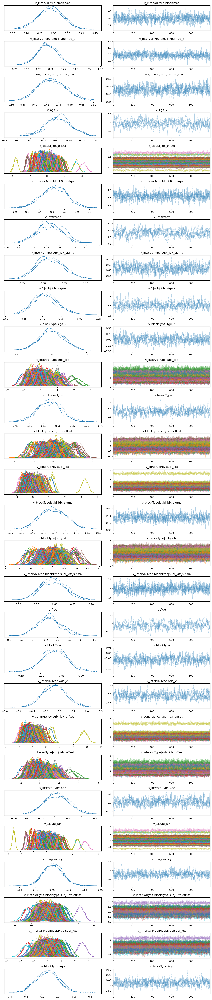

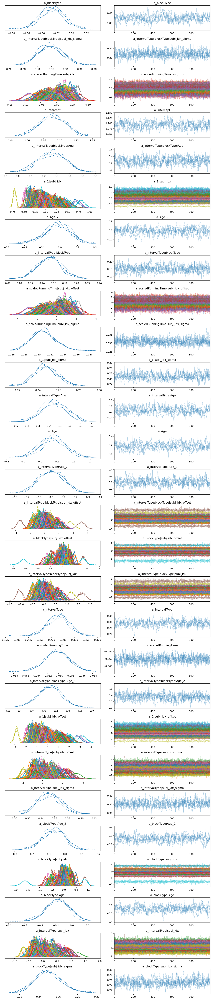

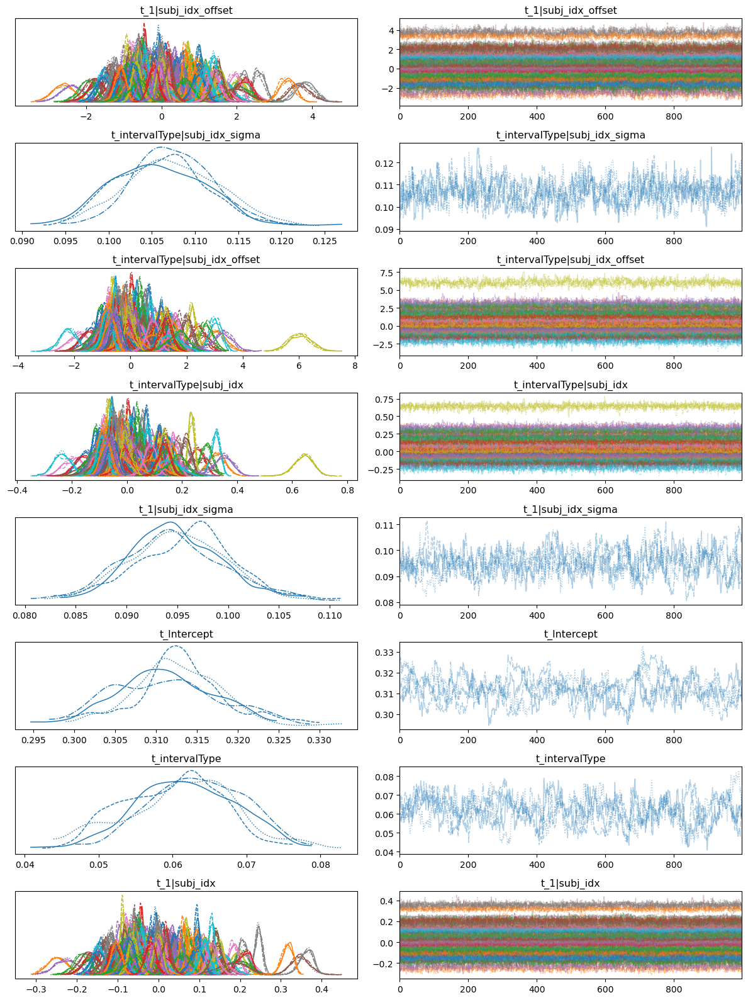

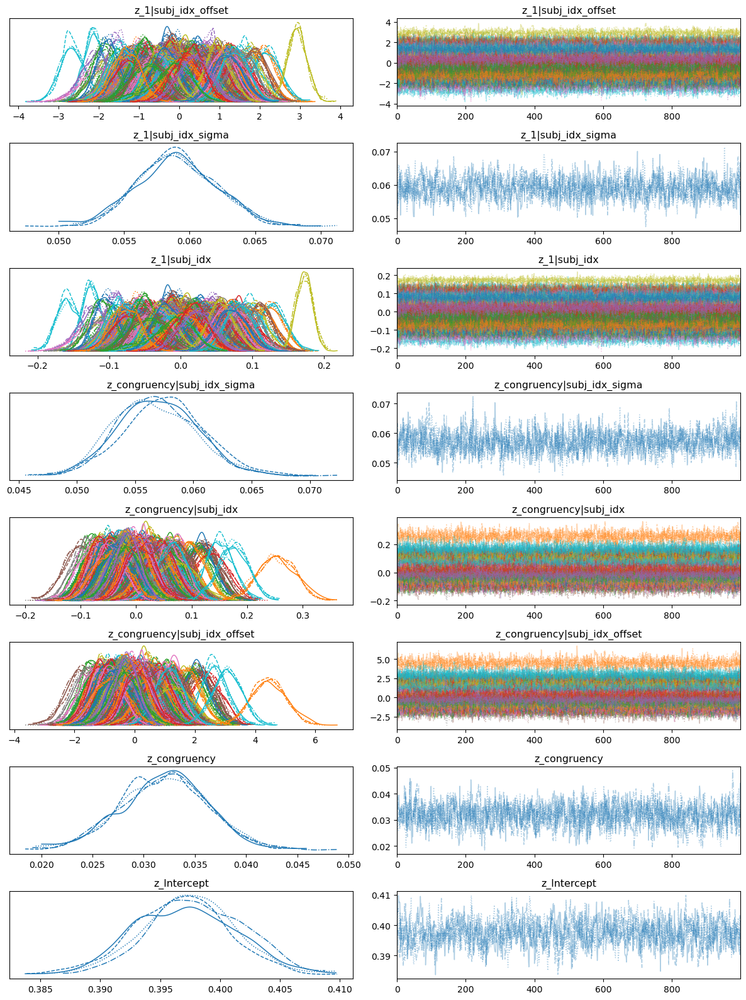

In [12]:
# Plot traces
hssm_analyze.plot_traces(model, var_names='v_') 
hssm_analyze.plot_traces(model, var_names='a_') 
hssm_analyze.plot_traces(model, var_names='t_') 
hssm_analyze.plot_traces(model, var_names='z_') 

### PPCs

No posterior predictive samples found. Generating posterior predictive samples using the provided InferenceData object and the original data. This will modify the provided InferenceData object, or if not provided, the traces object stored inside the model.


<Figure size 3000x3000 with 0 Axes>

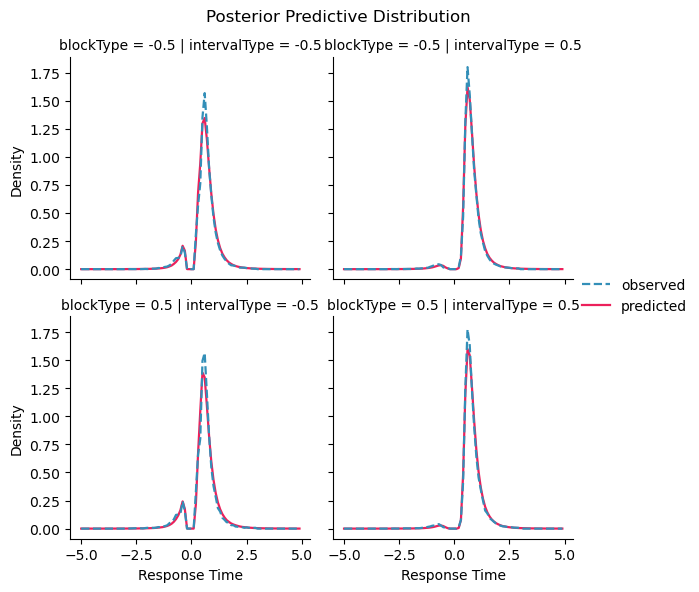

In [13]:
# Plot the PPCs
hssm_analyze.plot_ppcs(model, col_var="intervalType", row_var="blockType", x_size=30, y_size=30)

<Figure size 3000x3000 with 0 Axes>

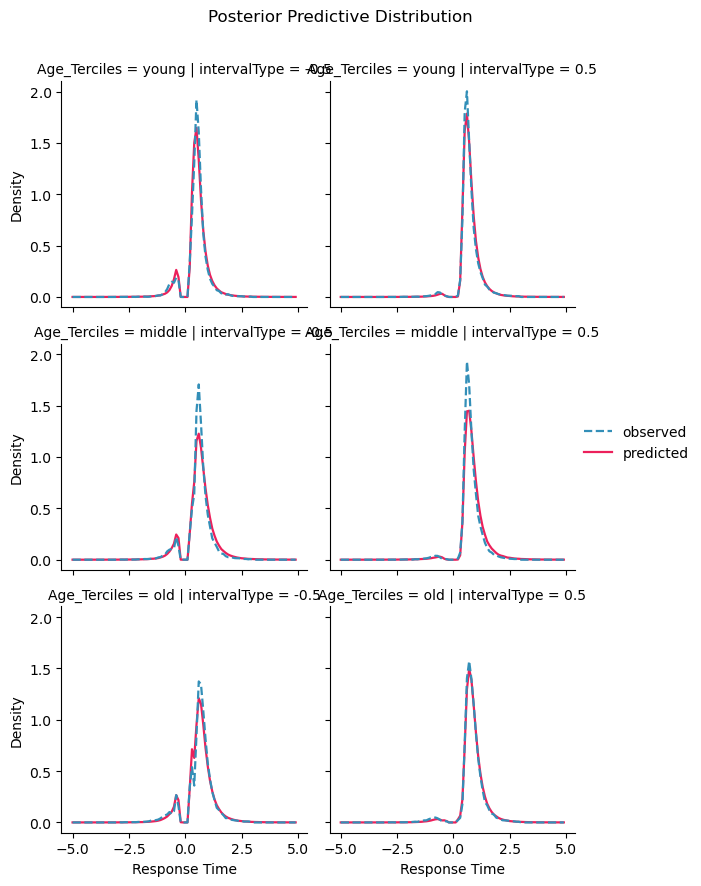

In [14]:
model.data['Age_Terciles'] = pd.qcut(model.data['Age'], q=3, labels=['young', 'middle', 'old'])
hssm_analyze.plot_ppcs(model, col_var="intervalType", row_var="Age_Terciles", x_size=30, y_size=30)

## Switch vs. repeat

### Summary

In [15]:
# Set parameters
model_name = 'Model3'
var_names=["v_Intercept",
           "v_intervalType",
           "v_Switch",
           "v_Age",
           "v_intervalType:Age",
           "v_Switch:Age",
           "v_intervalType:Switch",
           "v_intervalType:Switch:Age",
           "a_Intercept",
           "a_scaledRunningTime", 
           "a_intervalType", 
           "a_Switch", 
           "a_Age",
           "a_intervalType:Age",
           "a_Switch:Age",
           "a_intervalType:Switch",
           "a_intervalType:Switch:Age",
           "z_Intercept",
           "z_congruency", 
           "t_Intercept", 
           "t_intervalType",
           "p_outlier"]
# Attach the samples
model = hssm_analyze.load_model(model_name)

# Summarize the model
def generate_summary_with_posterior_prob(model, var_names):
    """
    Generate a summary table for the given model and variables,
    and add the posterior probability of being < 0 for each parameter.
    """
    # Get standard summary
    summary_df = az.summary(model._inference_obj, var_names=var_names)

    # Compute posterior probabilities < 0
    probs_below_zero = []
    for var in var_names:
        samples = az.extract(model._inference_obj, var_names=var, combined=True).values
        prob = np.mean(samples < 0)
        probs_below_zero.append(prob)

    # Add as new column
    summary_df["P(< 0)"] = probs_below_zero

    # Round all values to 2 decimals
    summary_df = summary_df.round(2)

    return summary_df

summary_with_prob = generate_summary_with_posterior_prob(model, var_names)
summary_with_prob


<string>:9: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
<string>:10: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
<string>:11: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`


User supplied initial value detected for v_Intercept, 
 skipping overwrite with default value.
User supplied initial value detected for a_Intercept, 
 skipping overwrite with default value.
User supplied initial value detected for t_Intercept, 
 skipping overwrite with default value.
Model initialized successfully.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat,P(< 0)
v_Intercept,2.60,0.05,2.52,2.70,0.00,0.00,246.0,419.0,1.02,0.00
v_intervalType,0.39,0.04,0.31,0.47,0.00,0.00,508.0,984.0,1.01,0.00
v_Switch,0.02,0.02,-0.01,0.05,0.00,0.00,1956.0,2199.0,1.00,0.08
v_Age,0.01,0.21,-0.36,0.41,0.01,0.01,228.0,411.0,1.00,0.46
v_intervalType:Age,-0.22,0.19,-0.56,0.17,0.01,0.00,525.0,1032.0,1.01,0.86
v_Switch:Age,-0.01,0.07,-0.14,0.12,0.00,0.00,1964.0,2151.0,1.00,0.54
v_intervalType:Switch,0.02,0.03,-0.03,0.08,0.00,0.00,1924.0,1735.0,1.00,0.20
v_intervalType:Switch:Age,-0.16,0.14,-0.42,0.09,0.00,0.00,1976.0,2135.0,1.00,0.88
a_Intercept,1.07,0.02,1.04,1.10,0.00,0.00,224.0,460.0,1.01,0.00
a_scaledRunningTime,-0.06,0.00,-0.06,-0.06,0.00,0.00,925.0,1230.0,1.01,1.00


### Plot

In [ ]:
# Set the z-scores for groups (the age predictor is multiplied by 100 before entered in the model, so we multiply it here as well)
young = -0.003297306 * 100 # 25
middle = -0.000865262 *100 # 45
old = 0.001566781 * 100     # 65

#### Drift ####

# Extract the means
v_Intercept = (az.extract(model._inference_obj,var_names = 'v_Intercept',combined=True)).mean().values
v_Interval = 0.5*(az.extract(model._inference_obj,var_names = 'v_intervalType',combined=True)).mean().values
v_Block = 0.5*(az.extract(model._inference_obj,var_names = 'v_Switch',combined=True)).mean().values
v_Age = (az.extract(model._inference_obj,var_names = 'v_Age',combined=True)).mean().values

v_IntervalXBlock = 0.25*(az.extract(model._inference_obj,var_names = 'v_intervalType:Switch',combined=True)).mean().values
v_IntervalXAge = 0.5*(az.extract(model._inference_obj,var_names = 'v_intervalType:Age',combined=True)).mean().values
v_BlockXAge = 0.5*(az.extract(model._inference_obj,var_names = 'v_Switch:Age',combined=True)).mean().values
v_IntervalXBlockXAge = 0.25*(az.extract(model._inference_obj,var_names = 'v_intervalType:Switch:Age',combined=True)).mean().values

# Recreate the conditions
v_SpeedFixed_young = v_Intercept - v_Interval + v_Block - v_IntervalXBlock + young*v_Age - young*v_IntervalXAge + young*v_BlockXAge - young*v_IntervalXBlockXAge
v_SpeedVarying_young = v_Intercept - v_Interval - v_Block + v_IntervalXBlock + young*v_Age - young*v_IntervalXAge - young*v_BlockXAge + young*v_IntervalXBlockXAge
v_AccuracyFixed_young = v_Intercept + v_Interval + v_Block + v_IntervalXBlock + young*v_Age + young*v_IntervalXAge + young*v_BlockXAge + young*v_IntervalXBlockXAge
v_AccuracyVarying_young = v_Intercept + v_Interval - v_Block - v_IntervalXBlock + young*v_Age + young*v_IntervalXAge - young*v_BlockXAge - young*v_IntervalXBlockXAge

v_SpeedFixed_middle = v_Intercept - v_Interval + v_Block - v_IntervalXBlock + middle*v_Age - middle*v_IntervalXAge + middle*v_BlockXAge - middle*v_IntervalXBlockXAge
v_SpeedVarying_middle = v_Intercept - v_Interval - v_Block + v_IntervalXBlock + middle*v_Age - middle*v_IntervalXAge - middle*v_BlockXAge + middle*v_IntervalXBlockXAge
v_AccuracyFixed_middle = v_Intercept + v_Interval + v_Block + v_IntervalXBlock + middle*v_Age + middle*v_IntervalXAge + middle*v_BlockXAge + middle*v_IntervalXBlockXAge
v_AccuracyVarying_middle = v_Intercept + v_Interval - v_Block - v_IntervalXBlock + middle*v_Age + middle*v_IntervalXAge - middle*v_BlockXAge - middle*v_IntervalXBlockXAge

v_SpeedFixed_old = v_Intercept - v_Interval + v_Block - v_IntervalXBlock + old*v_Age - old*v_IntervalXAge + old*v_BlockXAge - old*v_IntervalXBlockXAge
v_SpeedVarying_old = v_Intercept - v_Interval - v_Block + v_IntervalXBlock + old*v_Age - old*v_IntervalXAge - old*v_BlockXAge + old*v_IntervalXBlockXAge
v_AccuracyFixed_old = v_Intercept + v_Interval + v_Block + v_IntervalXBlock + old*v_Age + old*v_IntervalXAge + old*v_BlockXAge + old*v_IntervalXBlockXAge
v_AccuracyVarying_old = v_Intercept + v_Interval - v_Block - v_IntervalXBlock + old*v_Age + old*v_IntervalXAge - old*v_BlockXAge - old*v_IntervalXBlockXAge


#### Threshold ####

# Extract the means
a_Intercept = (az.extract(model._inference_obj,var_names = 'a_Intercept',combined=True)).mean().values
a_Interval = 0.5*(az.extract(model._inference_obj,var_names = 'a_intervalType',combined=True)).mean().values
a_Block = 0.5*(az.extract(model._inference_obj,var_names = 'a_Switch',combined=True)).mean().values
a_Age = (az.extract(model._inference_obj,var_names = 'a_Age',combined=True)).mean().values

a_IntervalXBlock = 0.25*(az.extract(model._inference_obj,var_names = 'a_intervalType:Switch',combined=True)).mean().values
a_IntervalXAge = 0.5*(az.extract(model._inference_obj,var_names = 'a_intervalType:Age',combined=True)).mean().values
a_BlockXAge = 0.5*(az.extract(model._inference_obj,var_names = 'a_Switch:Age',combined=True)).mean().values
a_IntervalXBlockXAge = 0.25*(az.extract(model._inference_obj,var_names = 'a_intervalType:Switch:Age',combined=True)).mean().values

# Recreate the conditions
a_SpeedFixed_young = a_Intercept - a_Interval + a_Block - a_IntervalXBlock + young*a_Age - young*a_IntervalXAge + young*a_BlockXAge - young*a_IntervalXBlockXAge
a_SpeedVarying_young = a_Intercept - a_Interval - a_Block + a_IntervalXBlock + young*a_Age - young*a_IntervalXAge - young*a_BlockXAge + young*a_IntervalXBlockXAge
a_AccuracyFixed_young = a_Intercept + a_Interval + a_Block + a_IntervalXBlock + young*a_Age + young*a_IntervalXAge + young*a_BlockXAge + young*a_IntervalXBlockXAge
a_AccuracyVarying_young = a_Intercept + a_Interval - a_Block - a_IntervalXBlock + young*a_Age + young*a_IntervalXAge - young*a_BlockXAge - young*a_IntervalXBlockXAge

a_SpeedFixed_middle = a_Intercept - a_Interval + a_Block - a_IntervalXBlock + middle*a_Age - middle*a_IntervalXAge + middle*a_BlockXAge - middle*a_IntervalXBlockXAge
a_SpeedVarying_middle = a_Intercept - a_Interval - a_Block + a_IntervalXBlock + middle*a_Age - middle*a_IntervalXAge - middle*a_BlockXAge + middle*a_IntervalXBlockXAge
a_AccuracyFixed_middle = a_Intercept + a_Interval + a_Block + a_IntervalXBlock + middle*a_Age + middle*a_IntervalXAge + middle*a_BlockXAge + middle*a_IntervalXBlockXAge
a_AccuracyVarying_middle = a_Intercept + a_Interval - a_Block - a_IntervalXBlock + middle*a_Age + middle*a_IntervalXAge - middle*a_BlockXAge - middle*a_IntervalXBlockXAge

a_SpeedFixed_old = a_Intercept - a_Interval + a_Block - a_IntervalXBlock + old*a_Age - old*a_IntervalXAge + old*a_BlockXAge - old*a_IntervalXBlockXAge
a_SpeedVarying_old = a_Intercept - a_Interval - a_Block + a_IntervalXBlock + old*a_Age - old*a_IntervalXAge - old*a_BlockXAge + old*a_IntervalXBlockXAge
a_AccuracyFixed_old = a_Intercept + a_Interval + a_Block + a_IntervalXBlock + old*a_Age + old*a_IntervalXAge + old*a_BlockXAge + old*a_IntervalXBlockXAge
a_AccuracyVarying_old = a_Intercept + a_Interval - a_Block - a_IntervalXBlock + old*a_Age + old*a_IntervalXAge - old*a_BlockXAge - old*a_IntervalXBlockXAge


# Young
data_young = {
    'condition': ['Speed', 'Speed', 'Accuracy', 'Accuracy'],
    'switch': ['Repeat', 'Switch', 'Repeat', 'Switch'],
    'v': [v_SpeedFixed_young, v_SpeedVarying_young, v_AccuracyFixed_young, v_AccuracyVarying_young],
    'a': [a_SpeedFixed_young, a_SpeedVarying_young, a_AccuracyFixed_young, a_AccuracyVarying_young]
}
means_young = pd.DataFrame(data_young)

# Middle
data_middle = {
    'condition': ['Speed', 'Speed', 'Accuracy', 'Accuracy'],
    'switch': ['Repeat', 'Switch', 'Repeat', 'Switch'],
    'v': [v_SpeedFixed_middle, v_SpeedVarying_middle, v_AccuracyFixed_middle, v_AccuracyVarying_middle],
    'a': [a_SpeedFixed_middle, a_SpeedVarying_middle, a_AccuracyFixed_middle, a_AccuracyVarying_middle]
}
means_middle = pd.DataFrame(data_middle)

# Old
data_old = {
    'condition': ['Speed', 'Speed', 'Accuracy', 'Accuracy'],
    'switch': ['Repeat', 'Switch', 'Repeat', 'Switch'],
    'v': [v_SpeedFixed_old, v_SpeedVarying_old, v_AccuracyFixed_old, v_AccuracyVarying_old],
    'a': [a_SpeedFixed_old, a_SpeedVarying_old, a_AccuracyFixed_old, a_AccuracyVarying_old]
}
means_old = pd.DataFrame(data_old)

# Define markers
markers = {'Repeat': 'o', 'Switch': '^'}

# Create subplots
fig, axes = plt.subplots(1, 3, figsize=(12, 4))

xlim = np.array([2.2,3.0])
ylim = np.array([0.8, 1.3])

# Plot for young
sns.scatterplot(ax=axes[0], data=means_young, x='v', y='a', hue='condition', style='switch', markers=markers, s=100)
axes[0].set_title('Young (25 yo)')
axes[0].set_xlim(xlim)
axes[0].set_ylim(ylim)
axes[0].set_xlabel('v')
axes[0].set_ylabel('a')

# Plot for middle
sns.scatterplot(ax=axes[1], data=means_middle, x='v', y='a', hue='condition', style='switch', markers=markers, s=100)
axes[1].set_title('Middle (45 yo)')
axes[1].set_xlim(xlim)
axes[1].set_ylim(ylim)
axes[1].set_xlabel('v')
axes[1].set_ylabel('a')

# Plot for old
sns.scatterplot(ax=axes[2], data=means_old, x='v', y='a', hue='condition', style='switch', markers=markers, s=100)
axes[2].set_title('Old (65 yo)')
axes[2].set_xlim(xlim)
axes[2].set_ylim(ylim)
axes[2].set_xlabel('v')
axes[2].set_ylabel('a')

# Adjust layout
plt.tight_layout()
plt.show()